In [1]:
%matplotlib widget
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('../')
sys.path.append('../../utils/')
from fig12code import *
import copy
from IPython.display import Image, display

## The correction can be applied using 
```
lake_object = dictobj(read_melt_lake_h5('<lake_file_name>.h5'))
depth_data_corrected, *info = surrf_correction(lake_object, correct=True)
```

The `lake_object` is also updated with the corrected data after `calling surrf_correction()`.

In [2]:
# input data
df_melling = pd.read_csv('data_melling_2024.csv',index_col=False)
df_fricker = pd.read_csv('data_fricker_2021.csv',index_col=False)


Antarctic lake 1
(Fricker et al., 2021)
applying SuRRF scattering correction.


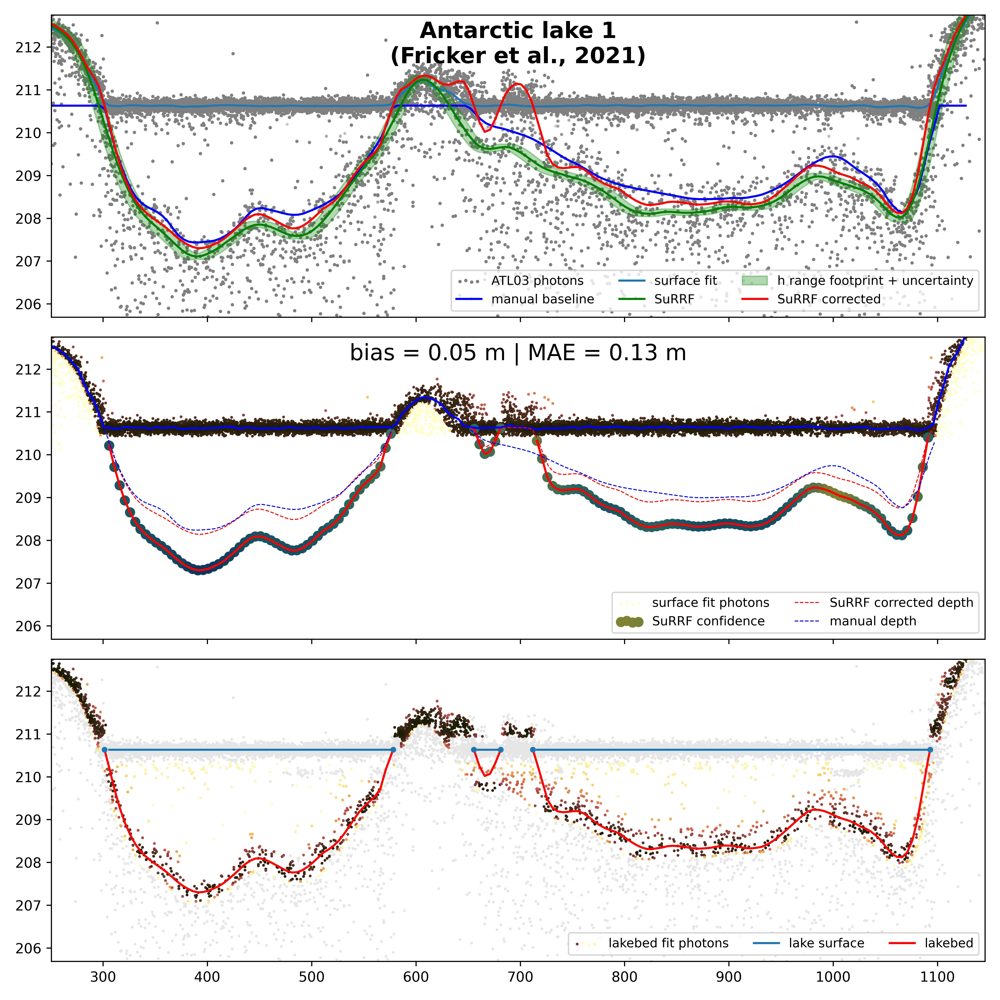


Antarctic lake 2
(Fricker et al., 2021)
applying SuRRF scattering correction.


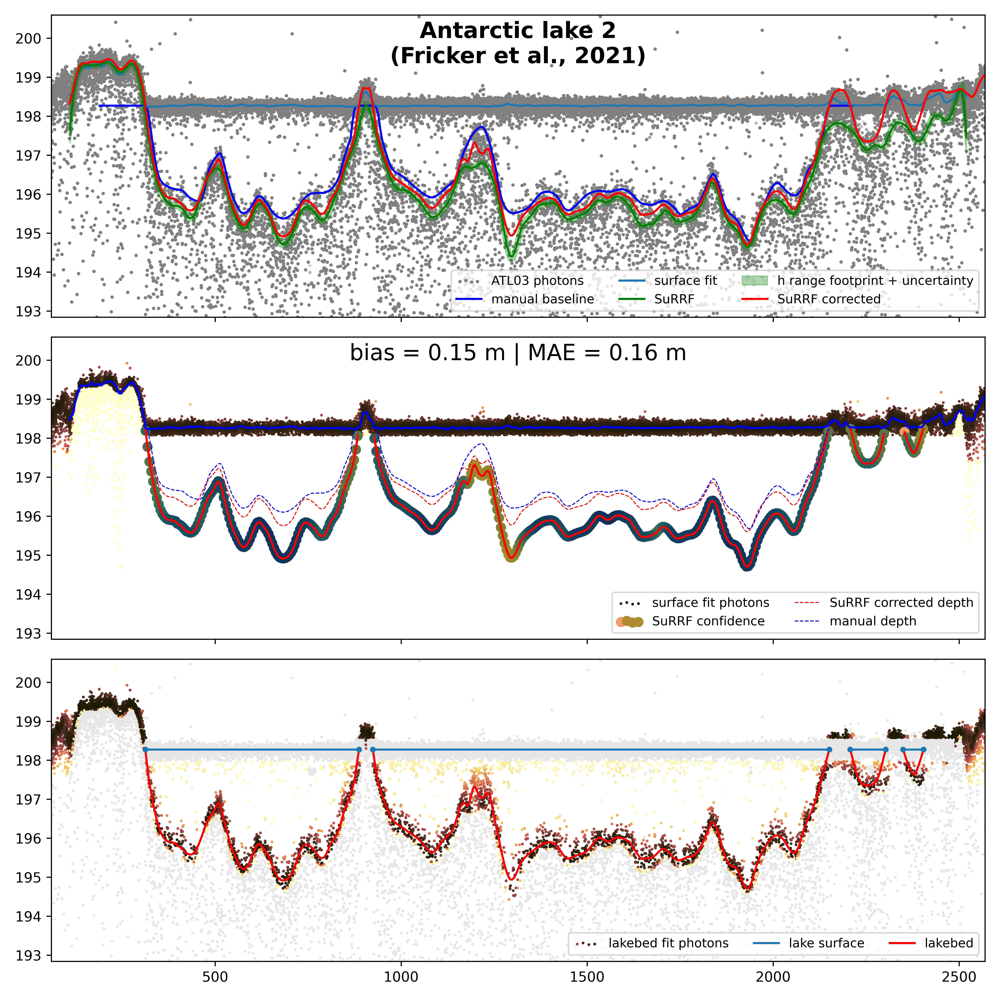


Antarctic lake 3
(Fricker et al., 2021)
applying SuRRF scattering correction.


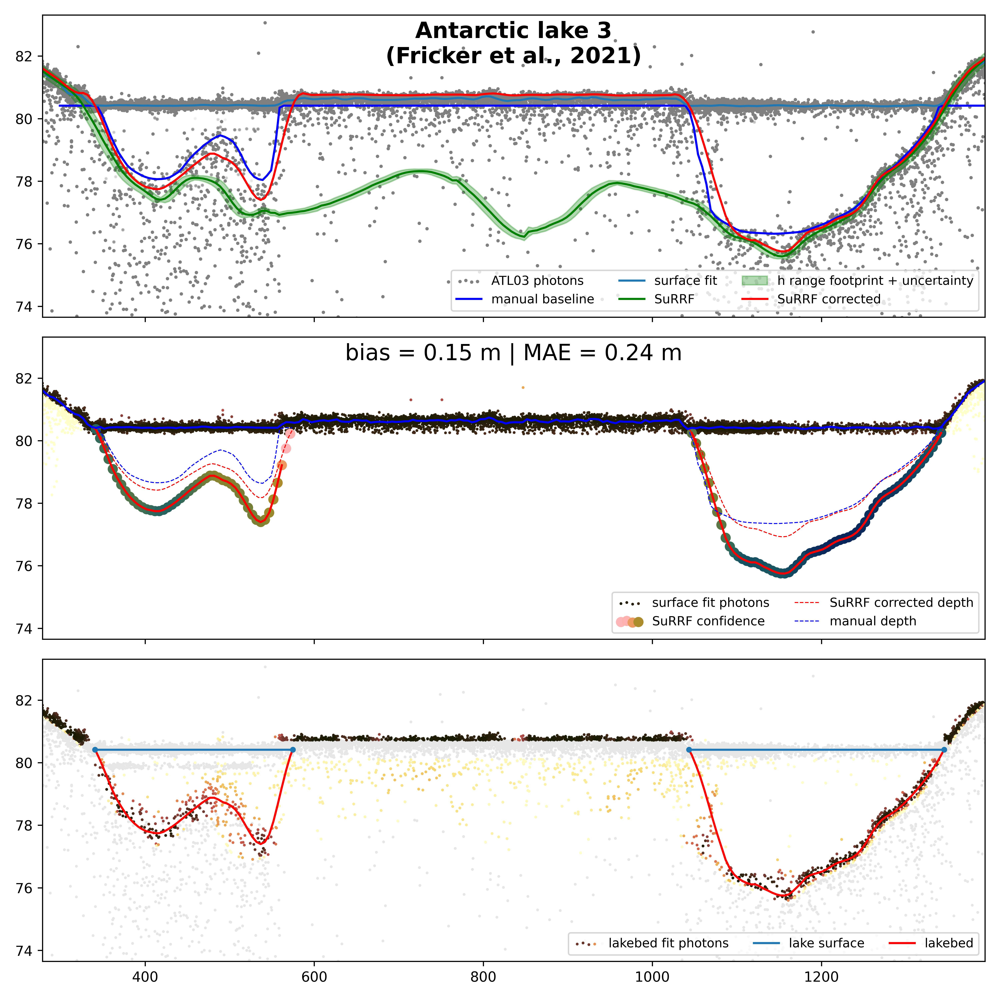


Antarctic lake 4
(Fricker et al., 2021)
applying SuRRF scattering correction.


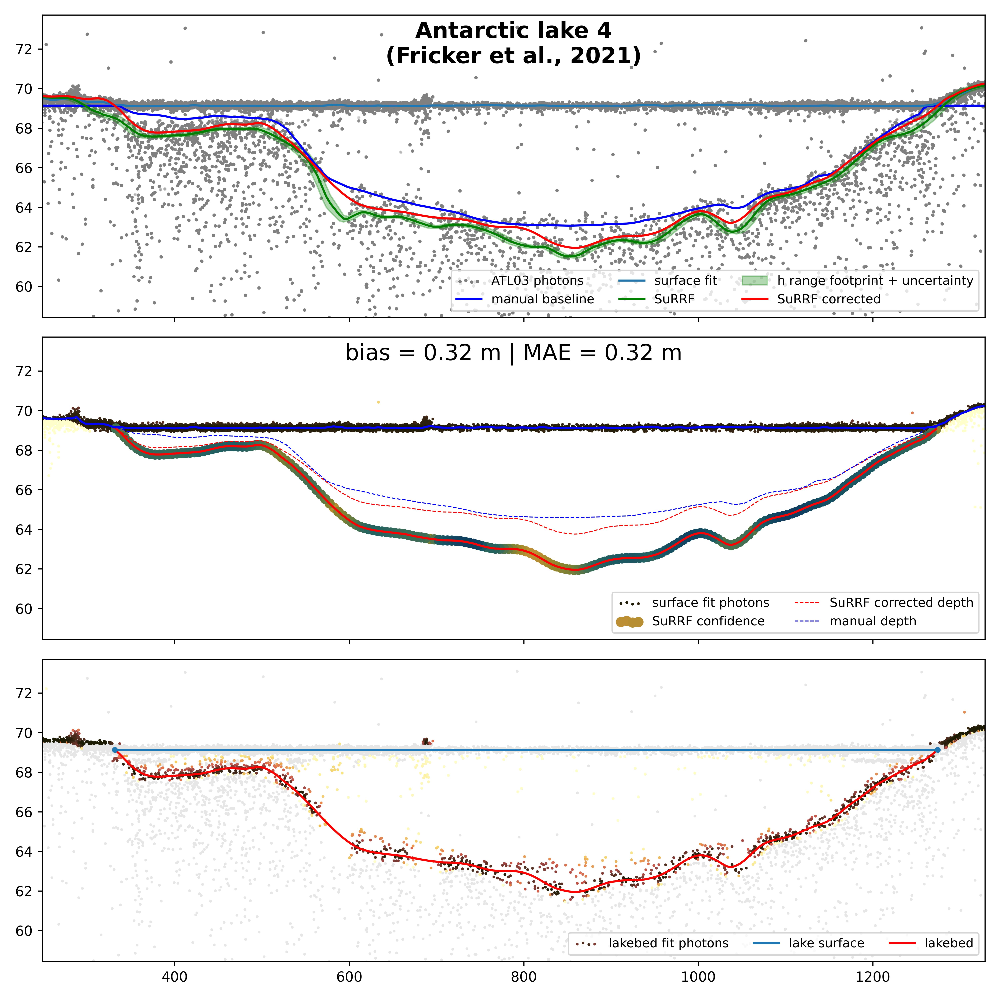


Greenland lake 1
(Melling et al., 2024)
applying SuRRF scattering correction.


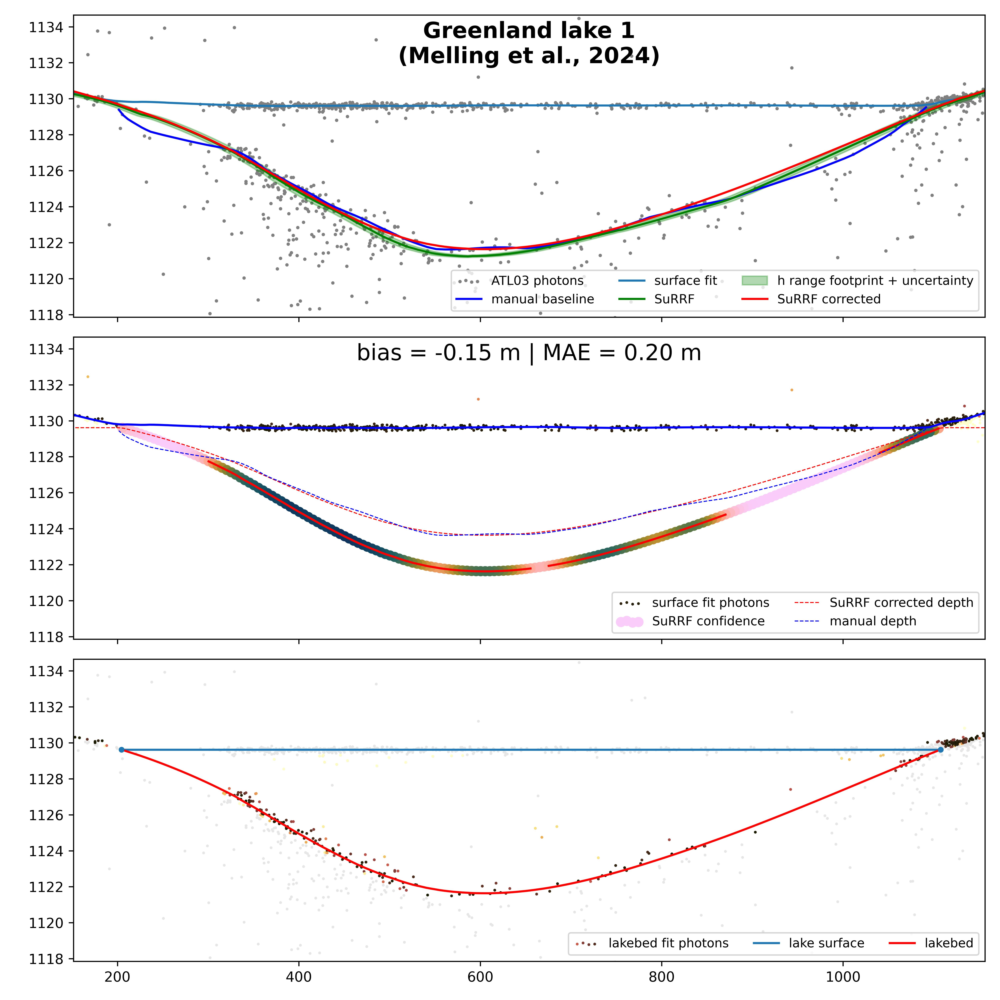


Greenland lake 2
(Melling et al., 2024)
applying SuRRF scattering correction.


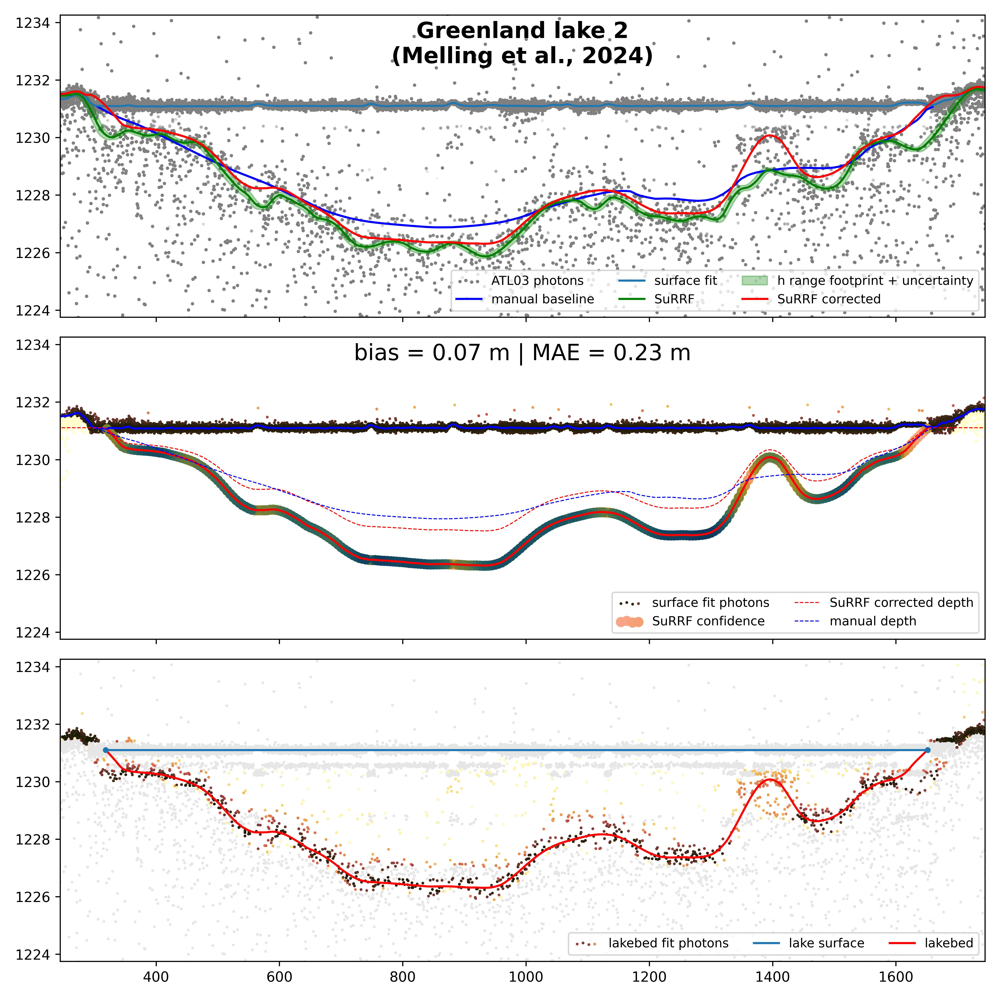


Greenland lake 3
(Melling et al., 2024)
applying SuRRF scattering correction.


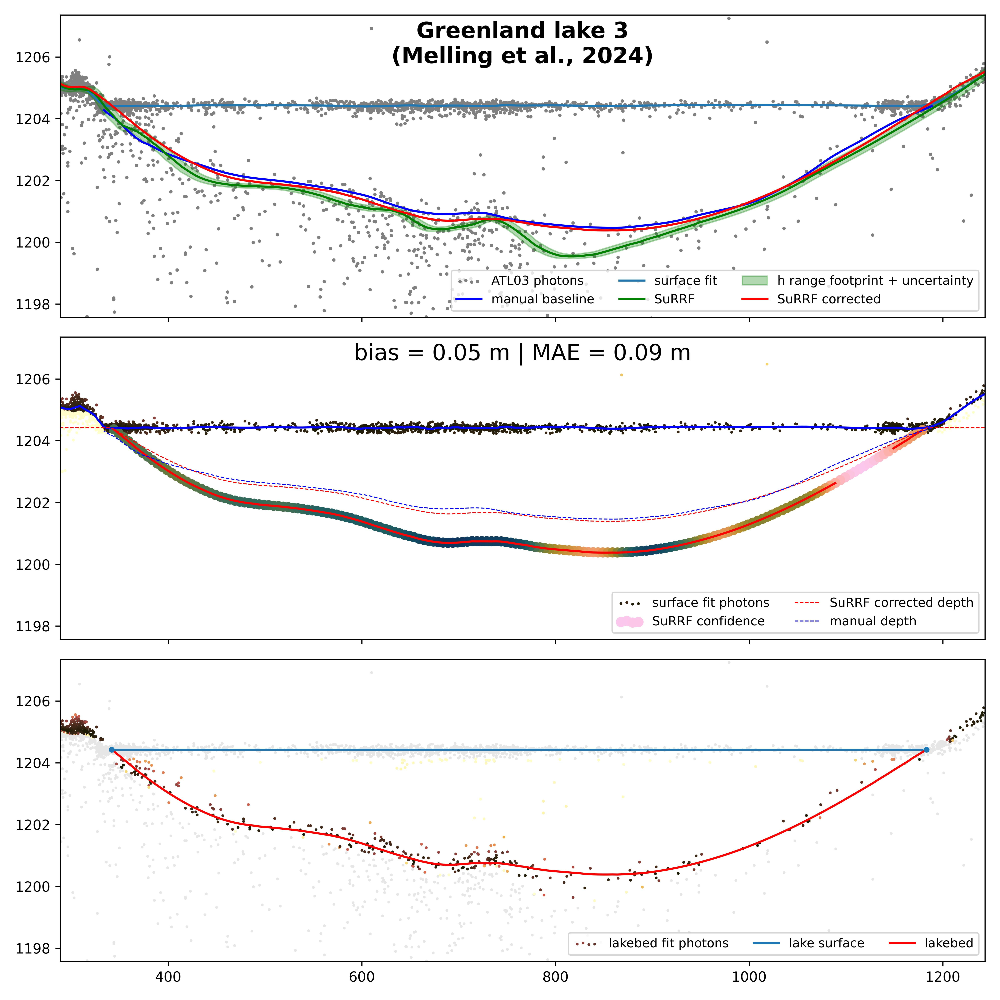


Greenland lake 4
(Melling et al., 2024)
applying SuRRF scattering correction.


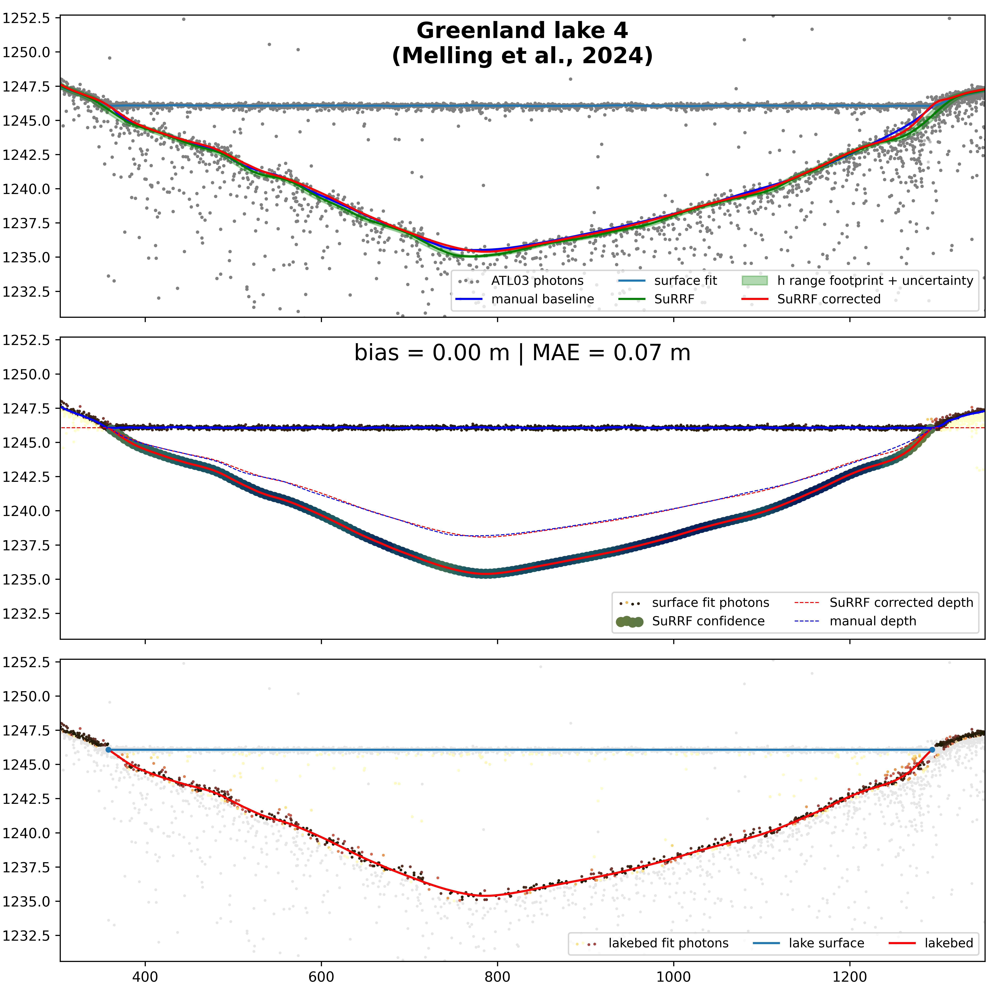


Greenland lake 5
(Melling et al., 2024)
applying SuRRF scattering correction.


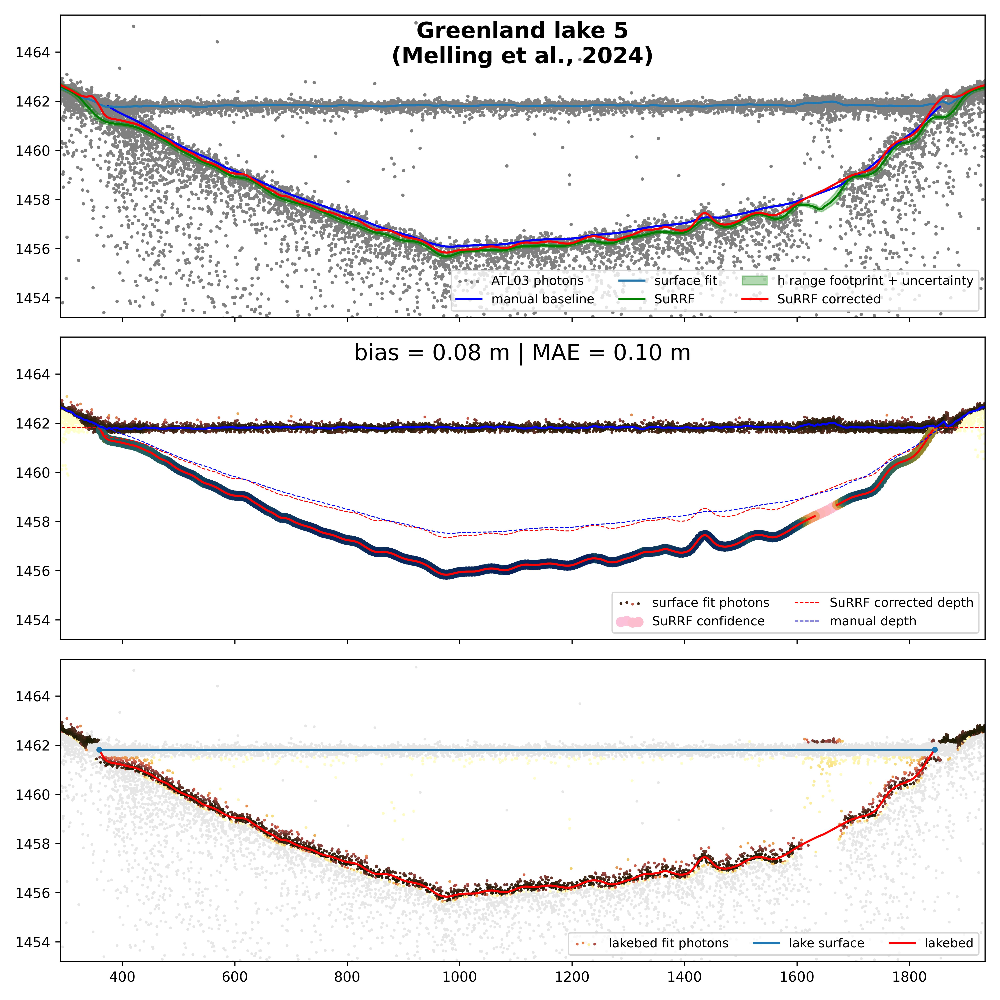

In [3]:
dfis = []
tries = np.arange(9)
for itry in np.arange(9):

    ref_idx = 1.336
    
    idxs = [x for x in enumerate(np.hstack((np.arange(1,5), np.arange(1,6))))]
    iplot, ilake = idxs[itry]
    
    source = 'fricker' if iplot < 4 else 'melling'
    source_txt = 'Fricker et al., 2021' if source=='fricker' else 'Melling et al., 2024'
    dfm = df_fricker if source=='fricker' else df_melling
    lake_file_name = 'lake_amery_fricker_%i.h5' % ilake if source=='fricker' else 'lake_greenland_melling_%i.h5' % ilake
    location = 'Antarctic' if source=='fricker' else 'Greenland'
    tit = '%s lake %i\n(%s)' % (location, ilake, source_txt)
    print('\n%s' % tit)
    
    selector = dfm.lake_id == ilake
    dfi_out = dfm[selector].copy()
    lk = dictobj(read_melt_lake_h5(lake_file_name))
    hsurf = lk.surface_elevation
    photon_data = lk.photon_data
    dfd = lk.depth_data
    
    lknew = copy.deepcopy(lk)
    # run SuRRF on new data
    # print('first pass')
    # dfdc, df_fit, df_nosurf, init_guess = surrf_correction(lknew, correct=False)
    dfdc = lknew.depth_data.copy()
    
    # print('second pass')
    lk_corr = copy.deepcopy(lknew)
    #-------------------------------------------
    dfdcc, df_fit, df_nosurf, init_guess, extent, evaldf = surrf_correction(lk_corr, correct=True)
    #-------------------------------------------
    dfi_out['surrf_corr'] = np.interp(dfi_out.dist_along_track_m, dfdcc.xatc, dfdcc.depth, left=np.nan, right=np.nan)
    dfi_out['surrf_corr_conf'] = np.interp(dfi_out.dist_along_track_m, dfdcc.xatc, dfdcc.conf, left=np.nan, right=np.nan)
    dfis.append(dfi_out)

    dfi = dfi_out.copy()
    
    # print('DONE!')

    # plt.close('all')

    xl = (dfd.xatc[dfd.depth>0].min()-50, dfd.xatc[dfd.depth>0].max()+50)
    yl = (hsurf-lk.max_depth*1.4*ref_idx, hsurf+lk.max_depth*0.6*ref_idx)
    
    fig, axs = plt.subplots(figsize=[10,10], nrows=3, sharex=True, sharey=True)
    
    df = lk_corr.photon_data
    
    ###########################################################
    ax = axs[0]
    ax.scatter(df.xatc[~df.is_afterpulse], df.h[~df.is_afterpulse], s=2, color='gray', alpha=np.clip(1-df[~df.is_afterpulse].prob_afterpulse,0,1), label='ATL03 photons')
    ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual*ref_idx, 'b-', label='manual baseline')
    ax.plot(dfdc.xatc, dfdc.h_fit_surf, color='C0', label='surface fit')
    ax.plot(dfdc.xatc, dfdc.h_fit_bed, color='g', ls='-', label='SuRRF')
    ax.text(0.5, 0.98, tit, ha='center', va='top', fontsize=16, transform=ax.transAxes, fontweight='bold')
    
    footprint_diameter = 11 # icesat-2 footprint diameter in meters
    ref_idx = 1.336 # refractive index for the speed of light in 0 degree C freshwater
    photon_precision_time = 800e-12 # Single-photon time-of-flight precision: 800 ps
    speed_of_light = 299792458 # m/s in vacuum
    def get_footprint_hrange(x):
        footprint_border = np.asarray([x.xatc - footprint_diameter/2, x.xatc + footprint_diameter/2])
        return np.abs(np.diff(np.interp(footprint_border, dfd.xatc, dfd.h_fit_bed))[0])
    hrange_footprint_atl03 = dfd.apply(get_footprint_hrange, axis=1)
    hrange_footprint_depth = hrange_footprint_atl03 / ref_idx
    uncert_atl03 = speed_of_light * photon_precision_time / 2
    uncert_depth = uncert_atl03 / ref_idx
    
    total_spread_atl03 = hrange_footprint_atl03 + uncert_atl03
    total_spread_depth = hrange_footprint_depth + uncert_depth
    
    upper_lim_atl03 = dfd.h_fit_bed + total_spread_atl03 / 2
    lower_lim_atl03 = dfd.h_fit_bed - total_spread_atl03 / 2 
    
    ax.fill_between(dfd.xatc, lower_lim_atl03, upper_lim_atl03, color='g', alpha=0.3, label='h range footprint + uncertainty')
    ax.plot(dfdcc.xatc, dfdcc.h_fit_bed, color='r', label='SuRRF corrected')
    ax.legend(loc='lower right', ncols=3, fontsize=9, scatterpoints=4)
    
    ###########################################################
    ax = axs[1]
    ax.scatter(df_fit.xatc, df_fit.h, s=1, c=df_fit.snr, cmap=cmc.lajolla, label='surface fit photons')
    d0 = dfdc.depth.copy()
    d1 = dfdcc.depth.copy()
    d0[d0==0] = np.nan
    d1[d1==0] = np.nan
    
    conft = 0.15
    d1[dfdcc.conf<conft] = np.nan
    ax.plot(dfdcc.xatc, hsurf - d1 * ref_idx, 'r-')
    dfpp = dfdcc.sort_values(by='conf')
    dfpp.loc[dfpp.depth==0,'xatc'] = np.nan
    ax.scatter(dfpp.xatc, dfpp.h_fit_bed, s=40, c=dfpp.conf, cmap=cmc.batlow_r, vmin=0, vmax=1, label='SuRRF confidence')
    ax.plot(dfdcc.xatc, dfdcc.h_fit_surf, color='b')
    
    dfi.loc[(dfi.surrf_corr==0) & (dfi.manual==0)] = np.nan
    bias = np.nanmean(dfi.surrf_corr - dfi.manual)
    mae = np.nanmean(np.abs(dfi.surrf_corr - dfi.manual))
    ax.text(0.5, 0.98, 'bias = %.2f m | MAE = %.2f m' % (bias, mae), ha='center', va='top', fontsize=16, transform=ax.transAxes)

    ax.plot(dfi.dist_along_track_m, hsurf-dfi.surrf_corr, color='r', ls='--', lw=0.7, label='SuRRF corrected depth')
    ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual, color='b', ls='--', lw=0.7, label='manual depth')

    ax.legend(loc='lower right', ncols=2, fontsize=9, scatterpoints=4)
    
    ###########################################################
    ax = axs[2]
    ax.scatter(df.xatc, df.h, s=1, color=[0.9]*3)
    ax.scatter(df_nosurf[~df_nosurf.is_afterpulse].xatc, df_nosurf[~df_nosurf.is_afterpulse].h, s=1, c=df_nosurf[~df_nosurf.is_afterpulse].snr, 
               cmap=cmc.lajolla, label='lakebed fit photons')
    ax.scatter(df_nosurf[df_nosurf.is_afterpulse].xatc, df_nosurf[df_nosurf.is_afterpulse].h, s=1, color='red')
    
    cols_sel = ['xatc','h_fit_bed','surf_elev','depth']
    dfp = dfdcc.copy()
    dfp['surf_elev'] = lk_corr.surface_elevation
    dfp = dfp[cols_sel]
    xinter, hinter = intersection(dfp.xatc, dfp.surf_elev, dfp.xatc, dfp.h_fit_bed)
    intersection_pts = pd.DataFrame({'xatc': xinter, 'h_fit_bed': hinter, 'depth': 1e-5, 'conf': 0.5})
    dfp = pd.concat((dfp, intersection_pts)).sort_values(by='xatc').reset_index(drop=True)
    dfp.loc[dfp.depth==0, 'xatc'] = np.nan
    ax.plot(dfp.xatc, dfp.surf_elev, color='C0', label='lake surface')
    ax.plot(dfp.xatc, dfp.h_fit_bed, color='r', label='lakebed')
    ax.scatter(intersection_pts.xatc, intersection_pts.h_fit_bed, s=10, color='C0', zorder=20)

    ax.legend(loc='lower right', ncols=3, fontsize=9, scatterpoints=4)
    
    ax.set_xlim(xl)
    ax.set_ylim(yl)
    fig.tight_layout()

    figname = 'correction_figs/%s_lake%i.jpg' % (location, ilake)
    fig.savefig(figname, dpi=600)

    plt.close(fig)
    display(Image(figname))

## Save the data

In [4]:
#### uncomment to save to csv
antdfs = pd.concat(dfis[:4]).reset_index(drop=True)
antdfs = antdfs[~antdfs.iloc[:,4:].isnull().all(1)].reset_index(drop=True)
antdfs['lake_id'] = antdfs.lake_id.astype(np.int8)
antdfs.to_csv('data_fricker_2021_surrfcorrected.csv', index=False)

In [5]:
#### uncomment to save to csv
gredfs = pd.concat(dfis[4:]).reset_index(drop=True)
gredfs = gredfs[~gredfs.iloc[:,4:].isnull().all(1)].reset_index(drop=True)
gredfs['lake_id'] = gredfs.lake_id.astype(np.int8)
gredfs.to_csv('data_melling_2024_surrfcorrected.csv', index=False)